# Compare different models on BICCN data

Recreates fig. 5b/c/e and S12/S13/S14/S16.

## Prepare: load in packages and shared data

In [1]:
import os
from pathlib import Path
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import gaussian_kde, pearsonr, spearmanr

import anndata as ad
import tensorflow as tf
import keras
import wandb
import crested
from tqdm import tqdm

2025-03-20 10:50:43.590209: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-03-20 10:50:43.647427: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI AVX512_BF16 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-03-20 10:50:44.666349: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [2]:
# Change font output to TrueType or smt, something that lets illustrator work with it
%matplotlib inline
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
matplotlib.rcParams['svg.fonttype'] = 'none' # needed for svg outputs

In [3]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


`data/README.md` has more information on where these files come from and what they are based on.  
Genomes can be downloaded from UCSC: [mm10](https://hgdownload.soe.ucsc.edu/goldenPath/mm10/bigZips/) and [hg38](https://hgdownload.soe.ucsc.edu/goldenPath/hg38/bigZips/)

In [4]:
# Directories
data_dir = Path("data/")
model_dir = Path("models/")
mm10_dir = Path("/staging/leuven/res_00001/genomes/mus_musculus/mm10_ucsc/fasta/")
hg38_dir = Path("/staging/leuven/res_00001/genomes/homo_sapiens/hg38_ucsc/fasta/")

# Files
borzoi_predictions_file = data_dir / "mouse_biccn_baseborzoi_preds.h5ad" # from get_borzoi_enhancer_predictions.py
folds_file = data_dir / "consensus_peaks_biccn_borzoifolds.tsv" # See data/README.md - Only needed for Borzoi split analysis
targets_file = data_dir / "targets_bor_mouse.txt" 

# Intermediate paths - files otherwise created in this notebook
adata_full_path = data_dir / "mouse_biccn_data_full.h5ad"
adata_ct_path = data_dir / "mouse_biccn_data_specific.h5ad"
adata_zu_path = data_dir / "mouse_zu_biccnspecificpeaks.h5ad"
specific_regions_file = data_dir / "specific_peaks_biccn.bed"
temp_preds_dir = data_dir / "temp_preds/" # Directory to save/load temporary model pred files to


We load both genomes because one of the example enhancers in fig. S14 is based from the human genome. All other work is done on the mouse genome.

In [5]:
genomes = {
    'mm10': crested.Genome(mm10_dir / "mm10.fa", mm10_dir / "mm10.chrom.sizes"),
    'hg38': crested.Genome(hg38_dir / "hg38.fa", hg38_dir / "hg38.chrom.sizes")
}
crested.register_genome(genomes['mm10'])

2025-03-20T10:51:10.645557+0100 INFO Genome mm10 registered.


### Set model paths

In [6]:
model_paths = {
    "Base DilatedCNN":              model_dir / "deepbiccn2_base.keras",
    "Fine-tuned DilatedCNN":        model_dir / "deepbiccn2_ft.keras",
    "Fine-tuned Borzoi":            model_dir / "borzoi_ft_consensus.keras",
    "Double fine-tuned Borzoi":     model_dir / "borzoi_ft_consensus_ft_specific.keras",
    "All-peak frozen Borzoi":       model_dir / "borzoi_frozen_ft_consensus.keras",
    "Specific-peak frozen Borzoi":  model_dir / "borzoi_frozen_ft_specific.keras",
}

model_paths_extra = {
    "Specific-finetuned Borzoi":    model_dir / "borzoi_ft_specific.keras",
    "Fine-tuned Borzoi CNN":        model_dir / "borzoi_cnn_ft_consensus.keras",
    "Double fine-tuned Borzoi CNN": model_dir / "borzoi_cnn_ft_consensus_ft_specific.keras",
}

model_paths_borsplit = {
    "Fine-tuned Borzoi":            model_dir / "borzoi_borsplit_ft_consensus.keras",
    "Double fine-tuned Borzoi":     model_dir / "borzoi_borsplit_ft_consensus_ft_specific.keras",
    "All-peak frozen Borzoi":       model_dir / "borzoi_frozen_borsplit_ft_consensus.keras",
    "Specific-peak frozen Borzoi":  model_dir / "borzoi_frozen_borsplit_ft_specific.keras",
}

# Model input size
model_sizes = {
    "Base DilatedCNN": 2114,
    "Fine-tuned DilatedCNN": 2114,
    "Fine-tuned Borzoi": 2048,
    "Double fine-tuned Borzoi": 2048,
    "All-peak frozen Borzoi": 2048,
    "Specific-peak frozen Borzoi": 2048,
    "Specific-finetuned Borzoi": 2048,
    "Fine-tuned Borzoi CNN": 2048,
    "Double fine-tuned Borzoi CNN": 2048,
}

# ID to use for file paths when saving model outputs
model_ids = {
	"Base DilatedCNN":              "deepbiccn2_base",
	"Fine-tuned DilatedCNN":        "deepbiccn2_ft",
	"Fine-tuned Borzoi":            "borzoi_ft_consensus",
	"Double fine-tuned Borzoi":     "borzoi_ft_consensus_ft_specific",
	"All-peak frozen Borzoi":       "borzoi_frozen_ft_consensus",
	"Specific-peak frozen Borzoi":  "borzoi_frozen_ft_specific",
	"Specific-finetuned Borzoi":    "borzoi_ft_specific",
	"Fine-tuned Borzoi CNN":        "borzoi_cnn_ft_consensus",
	"Double fine-tuned Borzoi CNN": "borzoi_cnn_ft_consensus_ft_specific"
}

palette = dict(zip(model_paths, sns.color_palette('Paired', len(model_paths))))
print(palette)

{'Base DilatedCNN': (0.6509803921568628, 0.807843137254902, 0.8901960784313725), 'Fine-tuned DilatedCNN': (0.12156862745098039, 0.47058823529411764, 0.7058823529411765), 'Fine-tuned Borzoi': (0.6980392156862745, 0.8745098039215686, 0.5411764705882353), 'Double fine-tuned Borzoi': (0.2, 0.6274509803921569, 0.17254901960784313), 'All-peak frozen Borzoi': (0.984313725490196, 0.6039215686274509, 0.6), 'Specific-peak frozen Borzoi': (0.8901960784313725, 0.10196078431372549, 0.10980392156862745)}


### Load in peak data

If you have the processed anndata saved, load it in here, otherwise load from bigwigs and re-process:  
Either way, somehow get `adata_full` (all peaks) and `adata_ct` (cell type-specific peaks)

In [7]:
# Load in full dataset from bigwigs, processing how you did before training the model
if os.path.exists(adata_full_path):
    adata_full = ad.read_h5ad(adata_full_path)
else:
    atac_dir, regions_file = crested.get_dataset("mouse_cortex_bigwig_cut_sites")
    adata_full = crested.import_bigwigs(
        bigwigs_folder = atac_dir,
        regions_file = regions_file,
        target_region_width=1000,  
        target="count", 
    )
    crested.pp.train_val_test_split(adata_full, strategy="chr", val_chroms=["chr8", "chr10"], test_chroms=["chr9", "chr18"])
    crested.pp.change_regions_width(adata_full, 2048)
    crested.pp.normalize_peaks(adata_full, top_k_percent=0.03)
    adata_full.write_h5ad(adata_full_path, compression = 'gzip', compression_opts=9)


In [8]:
# Load in from adata
# This is, barring very slight processing/seed differences, 
# adata_full filtered with crested.pp.filter_regions_on_specificity(adata, gini_std_threshold=1.0)
if os.path.exists(adata_ct_path):
    adata_ct = ad.read_h5ad(adata_ct_path)
    if 'split' not in adata_ct.var.columns:
        crested.pp.train_val_test_split(adata_ct, strategy="chr", val_chroms=["chr8", "chr10"], test_chroms=["chr9", "chr18"])
    if (adata_ct.var['end'].iloc[0]-adata_ct.var['start'].iloc[0]) != 2048:
        crested.pp.change_regions_width(adata_ct, 2048)
else:
    adata_ct = adata_full.copy()
    crested.pp.filter_regions_on_specificity(adata_ct, gini_std_threshold=1.0)


In [9]:
print(adata_full.var['split'].value_counts())
print(adata_ct.var['split'].value_counts())

split
train    440993
val       56064
test      49936
Name: count, dtype: int64
split
train    73326
val       9951
test      8198
Name: count, dtype: int64


In [10]:
# Optional: Add borzoi fold info
val_test_folds = {'fold4': 'val', 'fold3': 'test'}

# Read in and resize folds file to match 2048bp regions
folds = pd.read_csv(folds_file, sep = '\t', names = ['chr', 'start', 'end', 'region', 'fold'], usecols = ['region',  'fold'])
folds_split = folds['region'].str.extract(r"(?P<chr>chr.+):(?P<start>\d+)-(?P<end>\d+)")
folds_split['center'] = (folds_split['start'].astype(int) + folds_split['end'].astype(int)) // 2
folds_split['new_start'] = folds_split['center'] - 2048//2
folds_split['new_end'] = folds_split['center'] + 2048//2
folds['region'] =  folds_split['chr']+':'+folds_split['new_start'].astype(str)+'-'+folds_split['new_end'].astype(str)
folds = folds.set_index('region')
print(f"adata length: {adata_ct.n_vars}")
print(f"folds length: {len(folds)}")
print(f"adata in folds length: {adata_ct.var_names.isin(folds.index).sum()}")
print(f"folds in adata length: {folds.index.isin(adata_ct.var_names).sum()}")

# Drop duplicates (on edge of folds)
folds = folds[~folds.index.duplicated()]

# Add fold data to var
adata_full.var = adata_full.var.join(folds)
adata_ct.var = adata_ct.var.join(folds)

# Turn fold data into split data
fold_mapping = {fold: 'train' for fold in folds['fold'].unique()}
fold_mapping.update(val_test_folds)
adata_full.var['split_borzoi'] = adata_full.var['fold'].map(fold_mapping)
adata_ct.var['split_borzoi'] = adata_ct.var['fold'].map(fold_mapping)

# Check result
print(adata_full.var['split_borzoi'].value_counts(dropna=False))
print(adata_ct.var['split_borzoi'].value_counts(dropna=False))

# Make views that have only regions with borzoi split values
adata_full_bs = adata_full[:, ~pd.isna(adata_full.var['split_borzoi'])]
adata_ct_bs = adata_ct[:, ~pd.isna(adata_ct.var['split_borzoi'])]


adata length: 91475
folds length: 543877
adata in folds length: 91013
folds in adata length: 91013
split_borzoi
train    412252
val       72747
test      58876
NaN        3118
Name: count, dtype: int64
split_borzoi
train    67153
val      12974
test     10886
NaN        462
Name: count, dtype: int64


## Part 1: Compare performance with CNN models

### Load in Part 1-specific data

#### Get correlations for main models, BICCN split

In [11]:
# Get correlations for genes on full set
class_corr_full = {}

for model_name in model_paths.keys():
    saved_preds_path = os.path.join(temp_preds_dir, f"{model_ids[model_name]}_preds_full.npz")
    # If preds aren't saved, save them now:
    if not os.path.exists(saved_preds_path):
        crested.pp.change_regions_width(
            adata_full,
            model_sizes[model_name],
        )
        model = keras.models.load_model(model_paths[model_name], compile = False)
        preds = crested.tl.predict(adata_full, model)
        preds = preds.T
        np.savez(saved_preds_path, preds)
        print(f"Saved predictions to {saved_preds_path}")
    else:
        print(f"Loading predictions from {saved_preds_path}")
        with np.load(saved_preds_path) as f:
            preds = f['arr_0']
    # Get correlations
    x = np.log1p(adata_full.X[:, adata_full.var['split'] == 'test'])
    y = np.log1p(preds[:, adata_full.var['split'] == 'test'])
    class_corr_mat = np.corrcoef(x, y, rowvar = True)
    class_corr_full[model_name] = np.diag(np.hsplit(np.vsplit(class_corr_mat, 2)[1], 2)[0])
    del class_corr_mat

Loading predictions from data/temp_preds/deepbiccn2_base_preds_full.npz
Loading predictions from data/temp_preds/deepbiccn2_ft_preds_full.npz
Loading predictions from data/temp_preds/borzoi_ft_consensus_preds_full.npz
Loading predictions from data/temp_preds/borzoi_ft_consensus_ft_specific_preds_full.npz
Loading predictions from data/temp_preds/borzoi_frozen_ft_consensus_preds_full.npz
Loading predictions from data/temp_preds/borzoi_frozen_ft_specific_preds_full.npz


In [12]:
# Get correlations for genes on cell type-specific set
class_corr_ct = {}

for model_name in model_paths.keys():
    saved_preds_path = os.path.join(temp_preds_dir, f"{model_ids[model_name]}_preds_ct.npz")
    # If preds aren't saved, save them now:
    if not os.path.exists(saved_preds_path):
        crested.pp.change_regions_width(
            adata_ct,
            model_sizes[model_name],
        )
        model = keras.models.load_model(model_paths[model_name], compile = False)
        preds = crested.tl.predict(adata_ct, model)
        preds = preds.T
        np.savez(saved_preds_path, preds)
        print(f"Saved predictions to {saved_preds_path}")
    else:
        print(f"Loading predictions from {saved_preds_path}")
        with np.load(saved_preds_path) as f:
            preds = f['arr_0']
    x = np.log1p(adata_ct.X[:, adata_ct.var['split'] == 'test'])
    y = np.log1p(preds[:, adata_ct.var['split'] == 'test'])
    class_corr_mat = np.corrcoef(x, y, rowvar = True)
    class_corr_ct[model_name] = np.diag(np.hsplit(np.vsplit(class_corr_mat, 2)[1], 2)[0])
    del class_corr_mat

Loading predictions from data/temp_preds/deepbiccn2_base_preds_ct.npz
Loading predictions from data/temp_preds/deepbiccn2_ft_preds_ct.npz
Loading predictions from data/temp_preds/borzoi_ft_consensus_preds_ct.npz
Loading predictions from data/temp_preds/borzoi_ft_consensus_ft_specific_preds_ct.npz
Loading predictions from data/temp_preds/borzoi_frozen_ft_consensus_preds_ct.npz
Loading predictions from data/temp_preds/borzoi_frozen_ft_specific_preds_ct.npz


Region calculations are optional - Pearson isn't the best metric for comparing within-region differences between cell types (often 1 high and many low), and Spearman isn't either (as many low with a bit of noise will cause rank to be scrambled).

In [13]:
# Calculate gene correlations one at a time to not run out of memory - full adata
region_corr_full = {model_name: np.empty(adata_full.n_vars, dtype='float32') for model_name in model_paths.keys()}
for model_name in model_paths.keys():
    saved_preds_path = os.path.join(temp_preds_dir, f"{model_ids[model_name]}_preds_full.npz")
    with np.load(saved_preds_path) as f:
        preds = f['arr_0']
    print(f"Processing {model_name}")
    for i in tqdm(range(adata_full.n_vars)):
        # region_corr_full[model_name][i] = np.corrcoef(adata_full.X[:, i], preds[:, i])[0, 1]
        region_corr_full[model_name][i] = pearsonr(adata_full.X[:, i], preds[:, i])[0]

Processing Base DilatedCNN


100%|██████████| 546993/546993 [03:27<00:00, 2640.64it/s]


Processing Fine-tuned DilatedCNN


100%|██████████| 546993/546993 [03:27<00:00, 2641.37it/s]


Processing Fine-tuned Borzoi


100%|██████████| 546993/546993 [03:27<00:00, 2640.17it/s]


Processing Double fine-tuned Borzoi


100%|██████████| 546993/546993 [03:27<00:00, 2637.63it/s]


Processing All-peak frozen Borzoi


100%|██████████| 546993/546993 [03:27<00:00, 2635.24it/s]


Processing Specific-peak frozen Borzoi


100%|██████████| 546993/546993 [03:27<00:00, 2630.59it/s]


In [14]:
# Calculate gene correlations one at a time to not run out of memory - cell-type specific adata
region_corr_ct = {model_name: np.empty(adata_ct.n_vars, dtype='float32') for model_name in model_paths.keys()}
for model_name in model_paths.keys():
    saved_preds_path = os.path.join(temp_preds_dir, f"{model_ids[model_name]}_preds_ct.npz")
    with np.load(saved_preds_path) as f:
        preds = f['arr_0']
    print(f"Processing {model_name}")
    for i in tqdm(range(adata_ct.n_vars)):
        region_corr_ct[model_name][i] = pearsonr(adata_ct.X[:, i], preds[:, i])[0]

Processing Base DilatedCNN


100%|██████████| 91475/91475 [00:34<00:00, 2649.14it/s]


Processing Fine-tuned DilatedCNN


100%|██████████| 91475/91475 [00:34<00:00, 2640.57it/s]


Processing Fine-tuned Borzoi


100%|██████████| 91475/91475 [00:34<00:00, 2638.80it/s]


Processing Double fine-tuned Borzoi


100%|██████████| 91475/91475 [00:34<00:00, 2640.60it/s]


Processing All-peak frozen Borzoi


100%|██████████| 91475/91475 [00:34<00:00, 2637.15it/s]


Processing Specific-peak frozen Borzoi


100%|██████████| 91475/91475 [00:34<00:00, 2629.86it/s]


#### Get correlations for extra models, BICCN split

In [15]:
# Get correlations for genes on full set
class_corr_extra_full = {}

for model_name in model_paths_extra.keys():
    saved_preds_path = os.path.join(temp_preds_dir, f"{model_ids[model_name]}_preds_full.npz")
    # If preds aren't saved, save them now:
    if not os.path.exists(saved_preds_path):
        crested.pp.change_regions_width(
            adata_full,
            model_sizes[model_name],
        )
        model = keras.models.load_model(model_paths_extra[model_name], compile = False)
        print(f"Predicting for {model_name}")
        preds = crested.tl.predict(adata_full, model)
        preds = preds.T
        np.savez(saved_preds_path, preds)
        print(f"Saved predictions to {saved_preds_path}")
    else:
        print(f"Loading predictions from {saved_preds_path}")
        with np.load(saved_preds_path) as f:
            preds = f['arr_0']
    # Get correlations
    x = np.log1p(adata_full.X[:, adata_full.var['split'] == 'test'])
    y = np.log1p(preds[:, adata_full.var['split'] == 'test'])
    class_corr_mat = np.corrcoef(x, y, rowvar = True)
    class_corr_extra_full[model_name] = np.diag(np.hsplit(np.vsplit(class_corr_mat, 2)[1], 2)[0])
    del class_corr_mat

Loading predictions from data/temp_preds/borzoi_ft_specific_preds_full.npz
Loading predictions from data/temp_preds/borzoi_cnn_ft_consensus_preds_full.npz
Loading predictions from data/temp_preds/borzoi_cnn_ft_consensus_ft_specific_preds_full.npz


In [16]:
# Get correlations for genes on cell type-specific set
class_corr_extra_ct = {}

for model_name in model_paths_extra.keys():
    saved_preds_path = os.path.join(temp_preds_dir, f"{model_ids[model_name]}_preds_ct.npz")
    # If preds aren't saved, save them now:
    if not os.path.exists(saved_preds_path):
        crested.pp.change_regions_width(
            adata_ct,
            model_sizes[model_name],
        )
        model = keras.models.load_model(model_paths_extra[model_name], compile = False)
        print(f"Predicting for {model_name}")
        preds = crested.tl.predict(adata_ct, model)
        preds = preds.T
        np.savez(saved_preds_path, preds)
        print(f"Saved predictions to {saved_preds_path}")
    else:
        print(f"Loading predictions from {saved_preds_path}")
        with np.load(saved_preds_path) as f:
            preds = f['arr_0']
    x = np.log1p(adata_ct.X[:, adata_ct.var['split'] == 'test'])
    y = np.log1p(preds[:, adata_ct.var['split'] == 'test'])
    class_corr_mat = np.corrcoef(x, y, rowvar = True)
    class_corr_extra_ct[model_name] = np.diag(np.hsplit(np.vsplit(class_corr_mat, 2)[1], 2)[0])
    del class_corr_mat

Loading predictions from data/temp_preds/borzoi_ft_specific_preds_ct.npz
Loading predictions from data/temp_preds/borzoi_cnn_ft_consensus_preds_ct.npz
Loading predictions from data/temp_preds/borzoi_cnn_ft_consensus_ft_specific_preds_ct.npz


#### Get correlations for Borzoi split-trained models

In [17]:
# Get correlations for genes on full set
class_corr_full_bs = {}

for model_name in model_paths_borsplit.keys():
    saved_preds_path = os.path.join(temp_preds_dir, f"{model_ids[model_name]}_preds_full_bs.npz")
    # If preds aren't saved, save them now:
    if not os.path.exists(saved_preds_path):
        if adata_full_bs.var['end'].iloc[0]-adata_full_bs.var['start'].iloc[0] is not model_sizes[model_name]:
            crested.pp.change_regions_width(
                adata_full_bs,
                model_sizes[model_name],
            )
        model = keras.models.load_model(model_paths_borsplit[model_name], compile = False)
        preds = crested.tl.predict(adata_full_bs, model)
        preds = preds.T
        np.savez(saved_preds_path, preds)
        print(f"Saved predictions to {saved_preds_path}")
    else:
        print(f"Loading predictions from {saved_preds_path}")
        with np.load(saved_preds_path) as f:
            preds = f['arr_0']
    # Get correlations
    x = np.log1p(adata_full_bs.X[:, adata_full_bs.var['split_borzoi'] == 'test'])
    y = np.log1p(preds[:, adata_full_bs.var['split_borzoi'] == 'test'])
    class_corr_mat = np.corrcoef(x, y, rowvar = True)
    class_corr_full_bs[model_name] = np.diag(np.hsplit(np.vsplit(class_corr_mat, 2)[1], 2)[0])
    del class_corr_mat

Loading predictions from data/temp_preds/borzoi_ft_consensus_preds_full_bs.npz
Loading predictions from data/temp_preds/borzoi_ft_consensus_ft_specific_preds_full_bs.npz
Loading predictions from data/temp_preds/borzoi_frozen_ft_consensus_preds_full_bs.npz
Loading predictions from data/temp_preds/borzoi_frozen_ft_specific_preds_full_bs.npz


In [18]:
# Get correlations for genes on cell type-specific set
class_corr_ct_bs = {}

for model_name in model_paths_borsplit.keys():
    saved_preds_path = os.path.join(temp_preds_dir, f"{model_ids[model_name]}_preds_ct_bs.npz")
    # If preds aren't saved, save them now:
    if not os.path.exists(saved_preds_path):
        if adata_ct_bs.var['end'].iloc[0]-adata_ct_bs.var['start'].iloc[0] is not model_sizes[model_name]:
            crested.pp.change_regions_width(
                adata_ct_bs,
                model_sizes[model_name],
            )
        crested.pp.change_regions_width(
            adata_ct_bs,
            model_sizes[model_name],
        )
        model = keras.models.load_model(model_paths_borsplit[model_name], compile = False)
        preds = crested.tl.predict(adata_ct_bs, model)
        preds = preds.T
        np.savez(saved_preds_path, preds)
        print(f"Saved predictions to {saved_preds_path}")
    else:
        print(f"Loading predictions from {saved_preds_path}")
        with np.load(saved_preds_path) as f:
            preds = f['arr_0']
    x = np.log1p(adata_ct_bs.X[:, adata_ct_bs.var['split_borzoi'] == 'test'])
    y = np.log1p(preds[:, adata_ct_bs.var['split_borzoi'] == 'test'])
    class_corr_mat = np.corrcoef(x, y, rowvar = True)
    class_corr_ct_bs[model_name] = np.diag(np.hsplit(np.vsplit(class_corr_mat, 2)[1], 2)[0])
    del class_corr_mat

Loading predictions from data/temp_preds/borzoi_ft_consensus_preds_ct_bs.npz
Loading predictions from data/temp_preds/borzoi_ft_consensus_ft_specific_preds_ct_bs.npz
Loading predictions from data/temp_preds/borzoi_frozen_ft_consensus_preds_ct_bs.npz
Loading predictions from data/temp_preds/borzoi_frozen_ft_specific_preds_ct_bs.npz


### Plot CREsted model comparisons

Plots like these can be made with `crested.pl.violin.correlations()`.

#### Fig. 5b

Mean correlations - full:
{'Base DilatedCNN': 0.7859812537232994, 'Fine-tuned DilatedCNN': 0.7120010497489508, 'Fine-tuned Borzoi': 0.8034523158233787, 'Double fine-tuned Borzoi': 0.7882565791634322, 'All-peak frozen Borzoi': 0.7395909426793325, 'Specific-peak frozen Borzoi': 0.5461634769934544}
Mean correlations - specific:
{'Base DilatedCNN': 0.7394794327957207, 'Fine-tuned DilatedCNN': 0.7620887249529843, 'Fine-tuned Borzoi': 0.7471456204275115, 'Double fine-tuned Borzoi': 0.7676191358804063, 'All-peak frozen Borzoi': 0.6133754332901239, 'Specific-peak frozen Borzoi': 0.6321171379301543}


/tmp/ipykernel_4013387/1938728844.py:15: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs['A'].set_yticklabels(['Base', 'Fine-tuned', 'Fine-tuned', 'Double fine-tuned', 'All-peak', 'Specific-peak'])


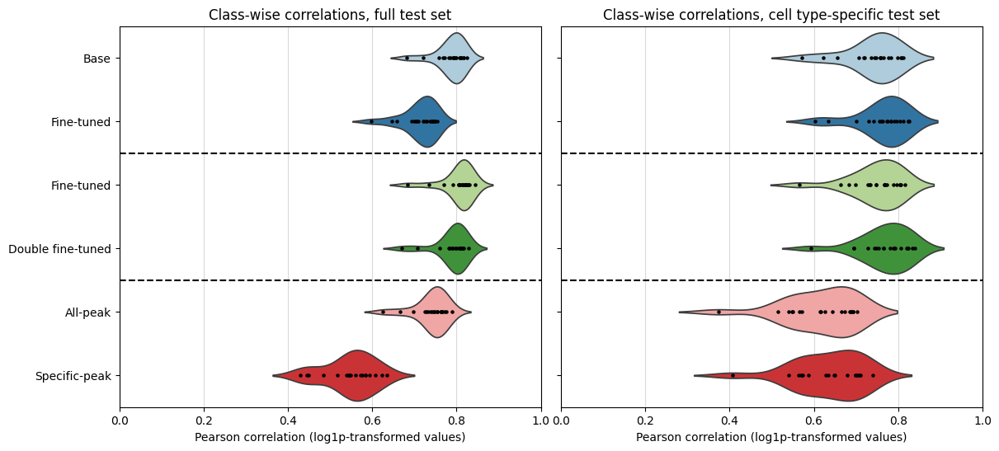

In [19]:
# Violin plots don't play nice with illustrator if saved as PDF. Tried to rasterize, ran into other problems.
# saving as SVG solves these issues, make sure you have matplotlib.rcParams['svg.fonttype'] = 'none' (see https://stackoverflow.com/questions/34387893/output-matplotlib-figure-to-svg-with-text-as-text-not-curves)

print("Mean correlations - full:")
print({k: np.mean(v) for k, v in class_corr_full.items()})
print("Mean correlations - specific:")
print({k: np.mean(v) for k, v in class_corr_ct.items()})

fig, axs = plt.subplot_mosaic("AABB", sharex = True, sharey = True, figsize = (13.5, 6))
axs['A'].grid(visible=True, which='major', axis='x', color = '.85')
sns.violinplot(class_corr_full, inner = 'point', palette = palette, ax = axs['A'], zorder = 2.4, orient = 'h', inner_kws={'s': 20, 'marker': '.', 'edgecolor': '0', 'color': '0.01', 'alpha': 1})
axs['A'].set_xlabel("Pearson correlation (log1p-transformed values)")
axs['A'].set_xlim((0, 1))
axs['A'].set_title("Class-wise correlations, full test set")
axs['A'].set_yticklabels(['Base', 'Fine-tuned', 'Fine-tuned', 'Double fine-tuned', 'All-peak', 'Specific-peak'])

axs['B'].grid(visible=True, which='major', axis='x', color = '.85')
sns.violinplot(class_corr_ct, inner = 'point', palette = palette, ax = axs['B'], zorder = 2.4, orient='h', inner_kws={'s': 20, 'marker': '.', 'edgecolor': '0', 'color': '0.01', 'alpha': 1})
axs['B'].set_xlabel("Pearson correlation (log1p-transformed values)")
axs['B'].set_xlim((0, 1))
axs['B'].set_title("Class-wise correlations, cell type-specific test set")
plt.subplots_adjust(wspace=0.1)
for separator in [1.5, 3.5]:
   axs['A'].axhline(separator, ls = '--', c = 'black', zorder = 2.5)
   axs['B'].axhline(separator, ls = '--', c = 'black', zorder = 2.5)

fig.savefig("figures/corr_class_violin_horizontal.svg", bbox_inches = 'tight', dpi = 1000)
fig.show()

#### Fig. S12

/tmp/ipykernel_4013387/91669254.py:16: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs['A'].set_xticklabels(axs['A'].get_xticklabels(), ha='right', rotation_mode='anchor')
/tmp/ipykernel_4013387/91669254.py:31: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs['B'].set_xticklabels(axs['B'].get_xticklabels(), ha='right', rotation_mode='anchor')


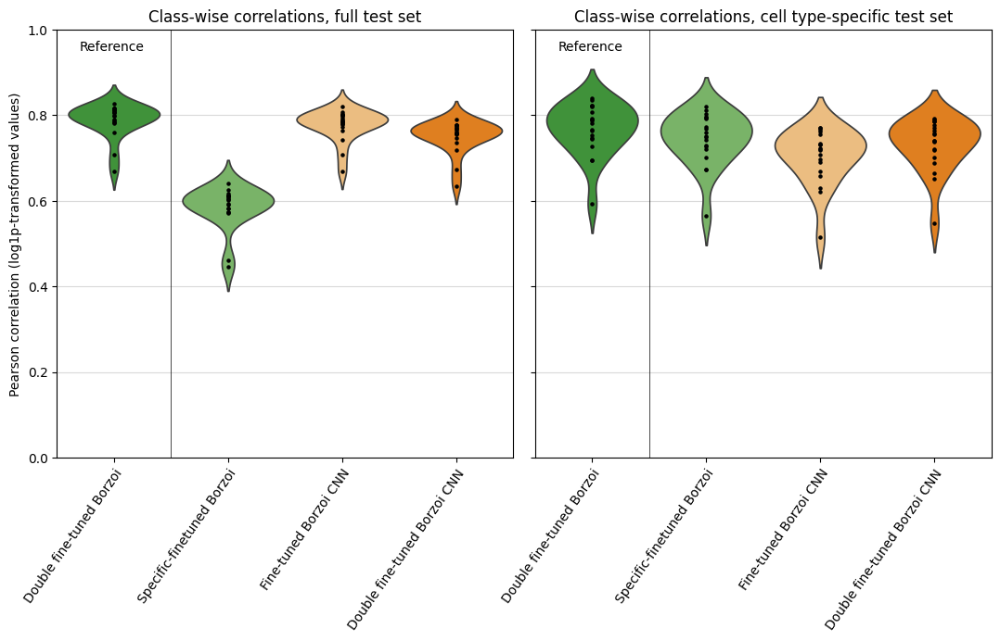

In [20]:
# Plot extra models for supplementary
# Violin plots don't play nice with illustrator if saved as PDF. Tried to rasterize, ran into other problems.
# saving as SVG solves these issues, make sure you have matplotlib.rcParams['svg.fonttype'] = 'none' (see https://stackoverflow.com/questions/34387893/output-matplotlib-figure-to-svg-with-text-as-text-not-curves)

palette_extra = {
    'Double fine-tuned Borzoi': palette["Double fine-tuned Borzoi"],
    'Fine-tuned Borzoi CNN': (0.9921568627450981, 0.7490196078431373, 0.43529411764705883), # Next paired colorpair
    'Double fine-tuned Borzoi CNN': (1.0, 0.4980392156862745, 0.0), # Next paired colorpair
    'Specific-finetuned Borzoi': (0.4490196078431372, 0.7509803921568627, 0.35686274509803917) # Average of 2 Borzoi colors
}

fig, axs = plt.subplot_mosaic("AABB", sharex = True, sharey = True, figsize = (13, 6))
axs['A'].grid(visible=True, which='major', axis='y', color = '.85')
sns.violinplot({"Double fine-tuned Borzoi": class_corr_full["Double fine-tuned Borzoi"], **class_corr_extra_full}, palette = palette_extra, inner = 'point', ax = axs['A'], zorder = 2.4, orient = 'v', inner_kws={'s': 20, 'marker': '.', 'edgecolor': '0', 'color': '0.01', 'alpha': 1})
axs['A'].tick_params(axis='x', labelrotation=55)
axs['A'].set_xticklabels(axs['A'].get_xticklabels(), ha='right', rotation_mode='anchor')
axs['A'].set_ylabel("Pearson correlation (log1p-transformed values)")
axs['A'].set_ylim((0, 1))
axs['A'].set_title("Class-wise correlations, full test set")
axs['A'].axvline(0.5, c = 'black', linewidth=0.50)
axs['A'].annotate(
        "Reference",
        xy=(0.05, 0.975),
        xycoords="axes fraction",
        verticalalignment="top",
    )

axs['B'].grid(visible=True, which='major', axis='y', color = '.85')
sns.violinplot({"Double fine-tuned Borzoi": class_corr_ct["Double fine-tuned Borzoi"], **class_corr_extra_ct}, palette = palette_extra, inner = 'point', ax = axs['B'], zorder = 2.4, orient='v', inner_kws={'s': 20, 'marker': '.', 'edgecolor': '0', 'color': '0.01', 'alpha': 1})
axs['B'].tick_params(axis='x', labelrotation=55)
axs['B'].set_xticklabels(axs['B'].get_xticklabels(), ha='right', rotation_mode='anchor')
axs['B'].set_ylabel("Pearson correlation (log1p-transformed values)")
axs['B'].set_ylim((0, 1))
axs['B'].set_title("Class-wise correlations, cell type-specific test set")
axs['B'].axvline(0.5, c = 'black', linewidth=0.50)
axs['B'].annotate(
        "Reference",
        xy=(0.05, 0.975),
        xycoords="axes fraction",
        verticalalignment="top",
    )
plt.subplots_adjust(wspace=0.1)

fig.savefig("figures/corr_class_violin_extra.svg", bbox_inches = 'tight', dpi = 1000)
fig.show()

/tmp/ipykernel_4013387/4040279770.py:9: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs['A'].set_xticklabels(axs['A'].get_xticklabels(), ha='right', rotation_mode='anchor')
/tmp/ipykernel_4013387/4040279770.py:18: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs['B'].set_xticklabels(axs['B'].get_xticklabels(), ha='right', rotation_mode='anchor')


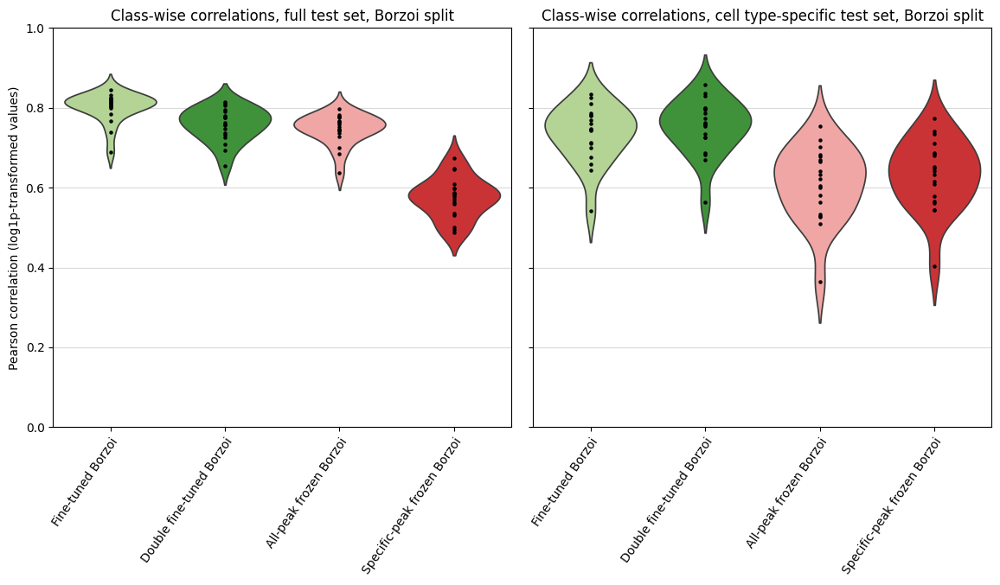

In [21]:
# Plot Borzoi split models for supplementary
# Violin plots don't play nice with illustrator if saved as PDF. Tried to rasterize, ran into other problems.
# saving as SVG solves these issues, make sure you have matplotlib.rcParams['svg.fonttype'] = 'none' (see https://stackoverflow.com/questions/34387893/output-matplotlib-figure-to-svg-with-text-as-text-not-curves)

fig, axs = plt.subplot_mosaic("AABB", sharex = True, sharey = True, figsize = (14, 6))
axs['A'].grid(visible=True, which='major', axis='y', color = '.85')
sns.violinplot(class_corr_full_bs, inner = 'point', ax = axs['A'], zorder = 2.4, palette = palette,  orient = 'v', inner_kws={'s': 20, 'marker': '.', 'edgecolor': '0', 'color': '0.01', 'alpha': 1})
axs['A'].tick_params(axis='x', labelrotation=55)
axs['A'].set_xticklabels(axs['A'].get_xticklabels(), ha='right', rotation_mode='anchor')
axs['A'].set_ylabel("Pearson correlation (log1p-transformed values)")
axs['A'].set_ylim((0, 1))
axs['A'].set_title("Class-wise correlations, full test set, Borzoi split")


axs['B'].grid(visible=True, which='major', axis='y', color = '.85')
sns.violinplot(class_corr_ct_bs, inner = 'point', ax = axs['B'], zorder = 2.4, palette = palette, orient='v', inner_kws={'s': 20, 'marker': '.', 'edgecolor': '0', 'color': '0.01', 'alpha': 1})
axs['B'].tick_params(axis='x', labelrotation=55)
axs['B'].set_xticklabels(axs['B'].get_xticklabels(), ha='right', rotation_mode='anchor')
axs['B'].set_ylabel("Pearson correlation (log1p-transformed values)")
axs['B'].set_ylim((0, 1))
axs['B'].set_title("Class-wise correlations, cell type-specific test set, Borzoi split")

plt.subplots_adjust(wspace=0.1)

fig.savefig("figures/corr_class_violin_borsplit.svg", bbox_inches = 'tight', dpi = 1000)
fig.show()

#### Extra figures

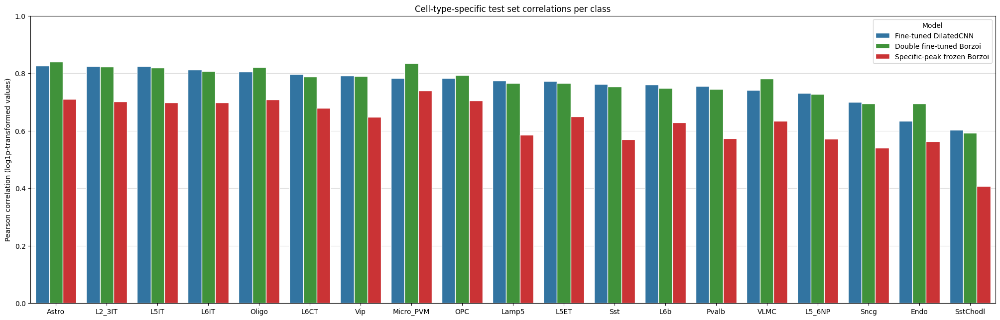

In [22]:
cell_type_order = adata_ct.obs_names[np.argsort(class_corr_ct["Fine-tuned DilatedCNN"])[::-1]] # Sort by specific model performance
models_for_barplot = ["Fine-tuned DilatedCNN", "Double fine-tuned Borzoi", "Specific-peak frozen Borzoi"] # Compare only a subset of models in barplot if you want 

fig, ax = plt.subplots(figsize = (25, 7.5))
sns.barplot(
    data = pd.DataFrame(
        {k: class_corr_ct[k] for k in models_for_barplot},
        index = adata_ct.obs_names
    ).reset_index(names='cell_type').melt(id_vars='cell_type', var_name = 'model_name', value_name = 'correlation'),
    x = 'cell_type',
    y = 'correlation',
    hue = 'model_name',
    ax = ax, 
    palette = palette,
    alpha = 1,
    edgecolor="1",
    order = cell_type_order,
    zorder = 2
)
ax.grid(visible=True, which='major', axis='y', color = '.85')
ax.set_ylim(0, 1)
ax.get_legend().set_title("Model")
ax.set_title("Cell-type-specific test set correlations per class")
ax.set_xlabel(None)
ax.set_ylabel("Pearson correlation (log1p-transformed values)")
fig.savefig("figures/corr_class_bar.pdf", bbox_inches = 'tight', dpi = 1000)
fig.show()

/tmp/ipykernel_4013387/3048004927.py:8: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs['A'].set_xticklabels(axs['A'].get_xticklabels(), ha='right', rotation_mode='anchor')
/tmp/ipykernel_4013387/3048004927.py:16: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs['B'].set_xticklabels(axs['B'].get_xticklabels(), ha='right', rotation_mode='anchor')


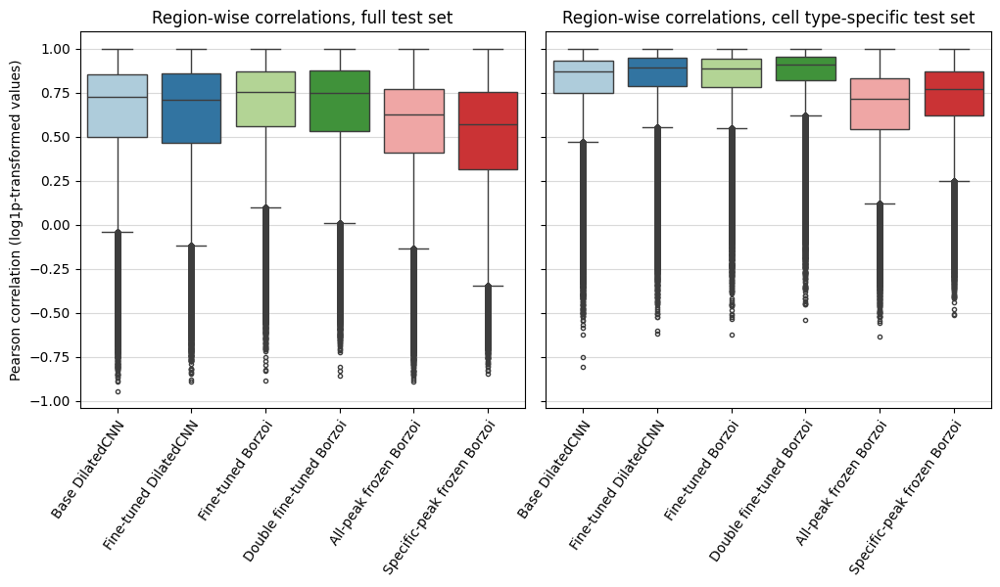

In [23]:
%matplotlib inline
fig, axs = plt.subplot_mosaic("AABB", sharey = True, figsize = (12, 5))

axs['A'].set_ylabel("Pearson correlation (log1p-transformed values)")
sns.boxplot(region_corr_full, palette = palette, ax = axs['A'], flierprops={"marker": ".", 'rasterized': True})
# sns.violinplot(region_corr_full, palette = palette, ax = axs['A'], zorder=2.01)
axs['A'].set_title("Region-wise correlations, full test set")
axs['A'].set_xticklabels(axs['A'].get_xticklabels(), ha='right', rotation_mode='anchor')
axs['A'].tick_params(axis='x', labelrotation=55)
axs['A'].grid(visible=True, which='major', axis='y', color = '.85', zorder = 1)

sns.boxplot(region_corr_ct, palette = palette, ax = axs['B'], flierprops={"marker": ".", 'rasterized': True})
# sns.violinplot(region_corr_ct, palette = palette, ax = axs['B'], zorder=2.01)
axs['B'].set_title("Region-wise correlations, cell type-specific test set")
axs['B'].tick_params(axis='x', labelrotation=55)
axs['B'].set_xticklabels(axs['B'].get_xticklabels(), ha='right', rotation_mode='anchor')
axs['B'].grid(visible=True, which='major', axis='y', color = '.85', zorder = 1)

plt.subplots_adjust(wspace=0.1)

fig.savefig("figures/corr_region_box.pdf", bbox_inches = 'tight')
fig.show()

## Part 2: Compare sequence explanations

### Load in part 2-specific functions and models

In [24]:
# Load in borzoi
model_file, output_names = crested.get_model('Borzoi_mouse_rep0')
borzoi = keras.models.load_model(model_file)
borzoi_seq_len = borzoi.input_shape[-2]
borzoi_output_len = borzoi.output_shape[-2]

# Make Borzoi wrapper that only returns center bin, to match (batch, output_classes) shape assumed by explainer functions
borzoi_centerslice = keras.Model(inputs = borzoi.input, outputs = borzoi.output[0][:, 3071, :])

2025-03-20 11:15:40.827883: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1928] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 78783 MB memory:  -> device: 0, name: NVIDIA H100 80GB HBM3, pci bus id: 0000:a6:00.0, compute capability: 9.0


In [25]:
def pad_seq(seq_1hot, seq_len):
    if seq_1hot.ndim == 2:
        seq_1hot = np.expand_dims(seq_1hot, axis=0)
    if seq_1hot.shape[1] < seq_len:
        padding = [(seq_len-seq_1hot.shape[1])//2, (seq_len-seq_1hot.shape[1])//2]
        if (seq_len-seq_1hot.shape[1]) % 2 == 1:
            padding[1] += 1
        seq_1hot = np.pad(seq_1hot, [[0, 0], padding, [0, 0]], mode = 'constant', constant_values = 0)
    return seq_1hot

### Get explanation scores

In [26]:
seq_len = 2048
coordinates = [
    ('mm10', "chr18", 61107803, 61109851, "Micro_PVM", 1089), # FIRE enhancer
    ('mm10', 'chr13', 92952861, 92953624, "SstChodl", 998),
    ('mm10', 'chr9', 56037220, 56037851, "L6b", 1069),
    ('hg38', 'chr11', 729566, 729984, "Oligo", 1090)
]

models_to_plot = ["Fine-tuned DilatedCNN", "Double fine-tuned Borzoi", "Specific-peak frozen Borzoi"]
assert all(model_name in model_paths.keys() for model_name in models_to_plot), "Check models_to_plot"
models = {}
for model_name, model_path in model_paths.items():
    if model_name in models_to_plot:
        models[model_name] = keras.models.load_model(model_path, compile = False)

In [27]:
# Get contribution scores
explainers = [{} for _ in coordinates]
output_seqs = [{} for _ in coordinates]
for i, (genome_name, chrom, start, end, class_name, borzoi_idx) in enumerate(coordinates):
    print(f"Explaining sequence {i}")
    # Get sequence
    center = (start + end)//2
    seq_1hot = crested.utils.one_hot_encode_sequence(genomes[genome_name].fetch(chrom, start, end))

    # Add scalar model attributions
    for model_name in models.keys():
        print(f"Model {model_name}")
        # Get deepexplainer
        scores, one_hot_encoded_sequences = crested.tl.contribution_scores(
            pad_seq(seq_1hot, models[model_name].input_shape[-2]),
            target_idx = list(adata_ct.obs_names).index(class_name),
            model = models[model_name],
            method="expected_integrated_grad",
            verbose = False
        )
        if scores.shape[-2] > 2048:
            to_crop = (scores.shape[-2] - 2048)//2
            scores = scores[:, :, to_crop:-to_crop, :]
            one_hot_encoded_sequences = one_hot_encoded_sequences[:, to_crop:-to_crop, :]
        explainers[i][model_name] = scores
        output_seqs[i][model_name] = one_hot_encoded_sequences
    
    # Add base Borzoi attributions
    borzoi_seq_start, borzoi_seq_end = center-borzoi_seq_len//2, center+borzoi_seq_len//2
    borzoi_output_start, borzoi_output_end = center-borzoi_output_len*32//2, center+borzoi_output_len*32//2
    
    borzoi_seq = genomes[genome_name].fetch(chrom, borzoi_seq_start, borzoi_seq_end)
    borzoi_seq_1hot = crested.utils.one_hot_encode_sequence(borzoi_seq)
    print("Model Borzoi")
    scores, one_hot_encoded_sequences = crested.tl.contribution_scores(
        borzoi_seq_1hot,
        target_idx = borzoi_idx,
        model = borzoi_centerslice,
        method="expected_integrated_grad",
        batch_size=1,
        verbose = False
    )
    
    # Save core 2048bp to match data structure of other models
    explainers[i][f"Base Borzoi - {output_names[borzoi_idx]}"] = scores[:, :, ((borzoi_seq_len - 2048)//2):-((borzoi_seq_len - 2048)//2)]
    output_seqs[i][f"Base Borzoi - {output_names[borzoi_idx]}"] = one_hot_encoded_sequences[:, ((borzoi_seq_len - 2048)//2):-((borzoi_seq_len - 2048)//2)]


Explaining sequence 0
Model Fine-tuned DilatedCNN


2025-03-20 11:15:51.392343: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:465] Loaded cuDNN version 8902


Model Double fine-tuned Borzoi
Model Specific-peak frozen Borzoi
Model Borzoi
Explaining sequence 1
Model Fine-tuned DilatedCNN
Model Double fine-tuned Borzoi
Model Specific-peak frozen Borzoi
Model Borzoi
Explaining sequence 2
Model Fine-tuned DilatedCNN
Model Double fine-tuned Borzoi
Model Specific-peak frozen Borzoi
Model Borzoi
Explaining sequence 3
Model Fine-tuned DilatedCNN
Model Double fine-tuned Borzoi
Model Specific-peak frozen Borzoi
Model Borzoi


### Plot explanation scores
#### Figs. 5e and S16

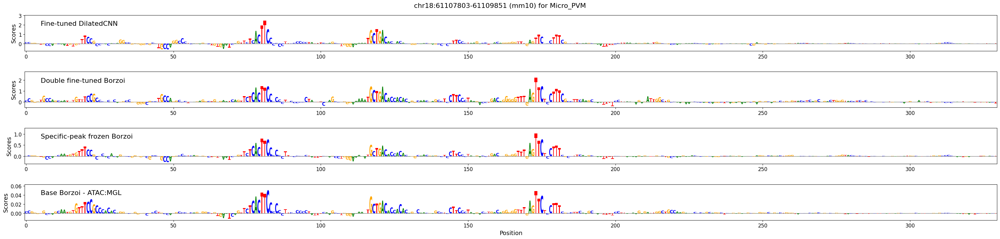

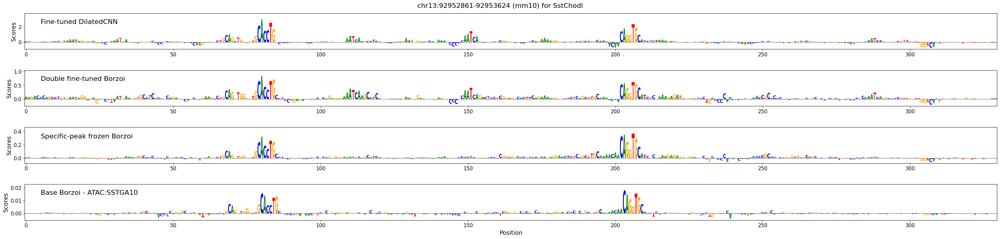

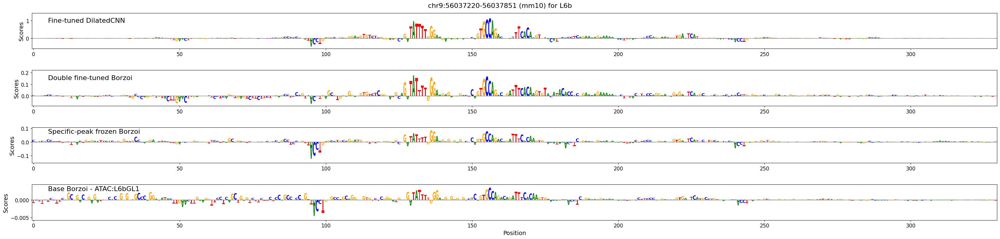

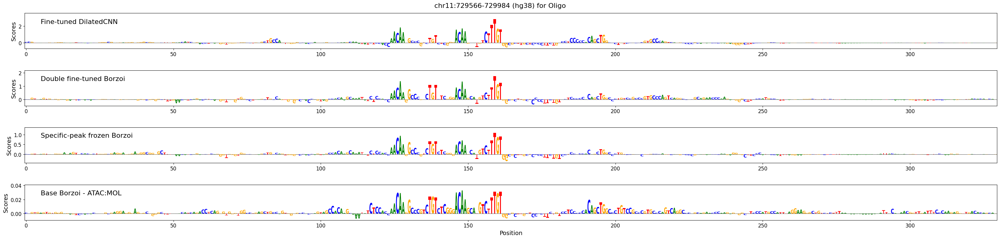

In [28]:
# Plot deepexplainers
%matplotlib inline

zoom_bp = 330
zoom = [
    (2048-330)//2, # Base center 330 bp zoom for FIRE enhancer of 2048bp already
    (2048-(coordinates[1][3] - coordinates[1][2]))//2+225, # Start of non-padded seq + 225
    (2048-(coordinates[2][3] - coordinates[2][2]))//2+275,
    (2048-(coordinates[3][3] - coordinates[3][2]))//2+50
]
for i, (genome_name, chrom, start, end, class_name, borzoi_idx) in enumerate(coordinates):
    # Plot sequence
    fig = crested.pl.patterns.contribution_scores(
        np.concatenate(list(explainers[i].values()), axis = 0)[:, :, zoom[i]:(zoom[i]+zoom_bp), :],
        np.concatenate(list(output_seqs[i].values()), axis = 0)[:, zoom[i]:(zoom[i]+zoom_bp), :],
        title=f"{chrom}:{start}-{end} ({genome_name}) for {class_name}",
        show = False
    )
    # Add annotations manually
    axs = fig.get_axes()
    for j, ax in enumerate(axs):
        ax.text(5, 0.7*ax.get_ylim()[1], list(explainers[i].keys())[j], fontsize=16, ha="left", va="center")
    # Remove x labels
    for ax in axs[:-1]:
        ax.set_xlabel(None)

    fig.savefig(f"figures/explainer_seq{i+1}.pdf", bbox_inches='tight')
    fig.show()

## Part 3: Compare base and finetuned Borzoi against ground truths
### Load in part 3-specific data

In [29]:
# Read in base borzoi predictions (from get_borzoi_enhancer_scores.py)
borzoi_ad = ad.read_h5ad(borzoi_predictions_file)

In [30]:
# Load in pre-saved model predictions (see part 1)
# Same as crested.tl.predict(adata_ct, model).T
for model_name in model_paths.keys():
    saved_preds_path_ct = os.path.join(temp_preds_dir, f"{model_ids[model_name]}_preds_ct.npz")
    with np.load(saved_preds_path_ct) as f:
        adata_ct.layers[f"{model_name} predictions"] = f['arr_0']


In [31]:
# Read in Zu et al base data
if os.path.exists(adata_zu_path):
    adata_zu = ad.read_h5ad(adata_zu_path)
else:
    # Zu data: download from http://catlas.org/renlab_downloads/wholemousebrain/bigwig_macs2/
    zu_atac_dir = os.path.join(data_dir, "brain_bigwigs_zu/")
    # Specific peaks: created right here if not pre-saved
    if not os.path.exists(specific_regions_file):
        adata_ct.var.to_csv(specific_regions_file, sep = '\t', columns = ['chr', 'start', 'end'], header = False, index = False)
    adata_zu = crested.import_bigwigs(
        bigwigs_folder = zu_atac_dir,
        regions_file = specific_regions_file,
        target_region_width=1000,  
        target="mean", 
    )
    adata_zu = adata_zu[list(mapping_zu.values()), :].copy() #reorder to matching BICCN order
    crested.pp.train_val_test_split(adata_zu, strategy="chr", val_chroms=["chr8", "chr10"], test_chroms=["chr9", "chr18"])
    crested.pp.change_regions_width(adata_zu, 2048)
    
    adata_zu.write_h5ad(adata_zu_path, compression = 'gzip')

In [32]:
# Read in Borzoi targets file
targets = pd.read_csv(targets_file, sep = '\t', index_col = 0)

In [33]:
# Get mapping from BICCN classes to Borzoi and Zu et al classes
mapping_li = { # Classes in Borzoi
    'Astro':'ATAC:ASCG',       # Astrocytes, grey matter
    'Endo': 'ATAC:VEC',        # Vascular endothelial cells
    'L2_3IT': 'ATAC:ITL23GL1', # Excitatory neurons, Cortex L2/3
    'L5ET':'ATAC:PTGL5',       # Excitatory neurons, Cortex PT
    'L5IT':'ATAC:ITL5GL1',     # Excitatory neurons, Cortex L5
    'L5_6NP':'ATAC:NPGL5',     # Excitatory neurons, Cortex NP
    'L6_CT':'ATAC:CTGL6',      # Excitatory neurons, Cortex CT
    'L6IT':'ATAC:ITL6GL1',     # Excitatory neurons, Cortex L5
    'L6b': 'ATAC:L6bGL1',      # Excitatory neurons, Cortex L6b
    'Lamp5':'ATAC:LAMGA2',     # CGE-derived neurogliaform cells, Lamp5 - Cortex
    'Micro-PVM':'ATAC:MGL',    # Microglia
    'OPC': 'ATAC:OPC',         # Oligodendrocytes precursor cells
    'Oligo': 'ATAC:MOL',       # Mature oligodendrocytes
    'Pvalb':'ATAC:PVGA1',      # MGE-derived neurogliaform cells, Pvalb
    'Sncg': 'ATAC:VIPGA2',     # CGE-derived neurogliaform cells, Sncg
    'Sst':'ATAC:SSTGA1',       # MGE-derived neurogliaform cells, Sst
    'SstChodl': 'ATAC:SSTGA10',# MGE-derived neurogliaform cells, Chodl
    'VLMC': 'ATAC:VLMC1',      # Vascular and leptomeningeal cells
    'Vip': 'ATAC:VIPGA1'       # CGE-derived neurogliaform cells, Vip
} 

mapping_zu = {
    'Astro':'319_Astro-TE_NN',
    'Endo': '333_Endo_NN',
    'L2_3IT': '007_L2_3_IT_CTX_Glut',
    'L5ET':'022_L5_ET_CTX_Glut',
    'L5IT':'005_L5_IT_CTX_Glut',
    'L5_6NP':'032_L5_NP_CTX_Glut', # Not sure
    'L6_CT':'030_L6_CT_CTX_Glut',
    'L6IT':'004_L6_IT_CTX_Glut',
    'L6b': '029_L6b_CTX_Glut',
    'Lamp5':'049_Lamp5_Gaba',
    'Micro-PVM':'334_Microglia_NN',
    'OPC': '326_OPC_NN',
    'Oligo': '327_Oligo_NN',
    'Pvalb':'052_Pvalb_Gaba',
    'Sncg': '047_Sncg_Gaba',
    'Sst':'053_Sst_Gaba',
    'SstChodl': '056_Sst_Chodl_Gaba',
    'VLMC': '330_VLMC_NN',
    'Vip': '046_Vip_Gaba'
}

In [34]:
# Get relevant Borzoi output indices: all mouse brain tracks and only tracks matching to BICCN (cortex) classes
bbp_obs_idxes = {track_name: idx for idx, track_name in enumerate(borzoi_ad.obs_names)}
borzoi_all_track_idxes = np.array([bbp_obs_idxes[track_name] for track_name in targets['description'][targets['file'].str.contains('yangli') | targets['file'].str.contains('uw-atlas')]])
borzoi_matching_track_idxes = np.array([bbp_obs_idxes[track_name] for track_name in mapping_li.values()])

### Compare against BICCN Zemke data (training data)

#### Fig. S13

2025-03-20T11:33:33.858977+0100 INFO Plotting heatmap correlations for split: test, models: ['Base DilatedCNN predictions', 'Fine-tuned Borzoi predictions', 'All-peak frozen Borzoi predictions']
2025-03-20T11:33:34.275439+0100 INFO Plotting heatmap correlations for split: test, models: ['Fine-tuned DilatedCNN predictions', 'Double fine-tuned Borzoi predictions', 'Specific-peak frozen Borzoi predictions']


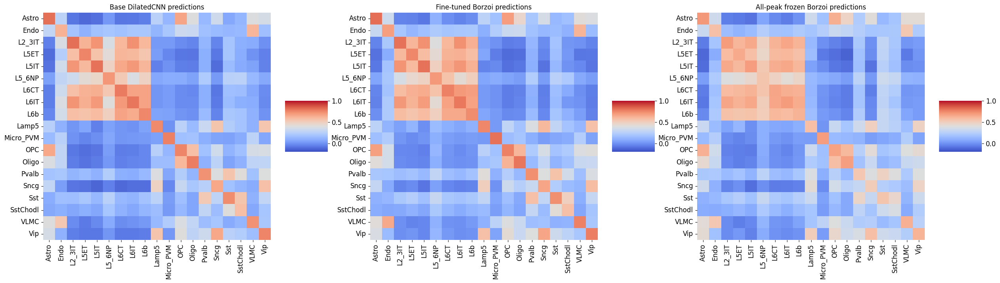

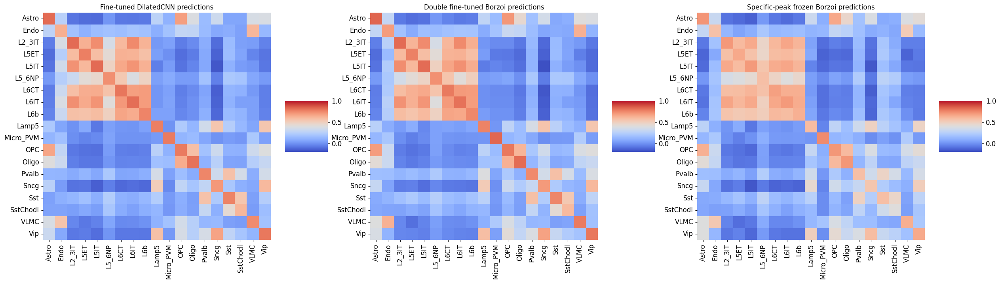

In [35]:
# Main 3 models vs adata (for supplement, as summarized in violinplots in main)
# Square colorbars are a casualty of forcing set_aspect equal to keep the plots square
# DilatedCNN heatmaps are same as fig. S2 so not including those

fig1 = crested.pl.heatmap.correlations_predictions(
    adata_ct,
    split="test",
    model_names = list(adata_ct.layers.keys())[::2],
    x_label_rotation=90,
    width=25,
    height=7.5,
    log_transform=True,
    vmax=1,
    vmin=-0.2,
    show = False,
)
fig2 = crested.pl.heatmap.correlations_predictions(
    adata_ct,
    split="test",
    model_names = list(adata_ct.layers.keys())[1::2],
    x_label_rotation=90,
    width=25,
    height=7.5,
    log_transform=True,
    vmax=1,
    vmin=-0.2,
    show = False,
)

for fig in fig1, fig2:
    axs = fig.get_axes()
    for ax in axs:
        ax.set_aspect('equal', adjustable='box')
fig1.savefig("figures/main_vs_biccnatac_heatmap_basemodels.pdf", dpi = 1000, bbox_inches='tight')
fig2.savefig("figures/main_vs_biccnatac_heatmap.pdf", dpi = 1000, bbox_inches='tight')

plt.show()

### Compare against Zu et al data (external data)

#### Fig. S14

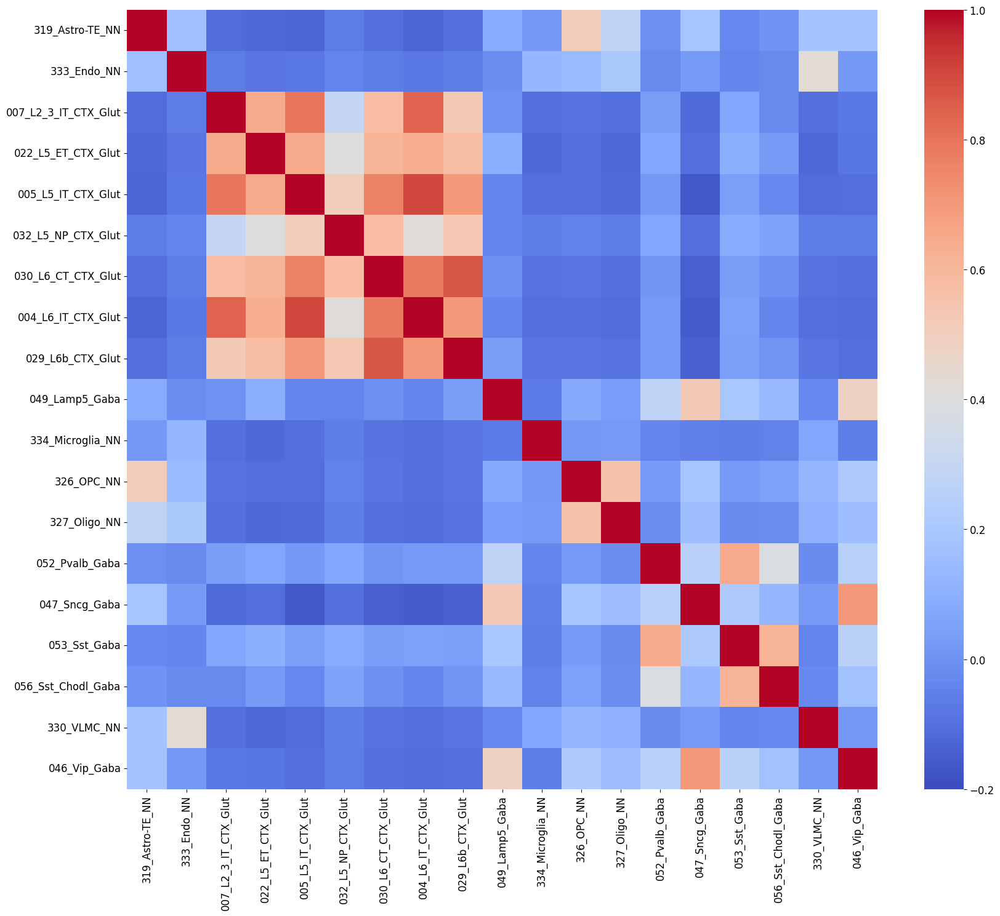

In [36]:
# Plot Zu et al self-correlation
fig = crested.pl.heatmap.correlations_self(
    adata_zu,
    x_label_rotation=90,
    width=17.5,
    height=15,
    log_transform=True,
    vmax=1,
    vmin=-0.2,
    show = False,
)
fig.savefig("figures/self_zuatac_heatmap.pdf", dpi = 1000, bbox_inches='tight')
fig.show()

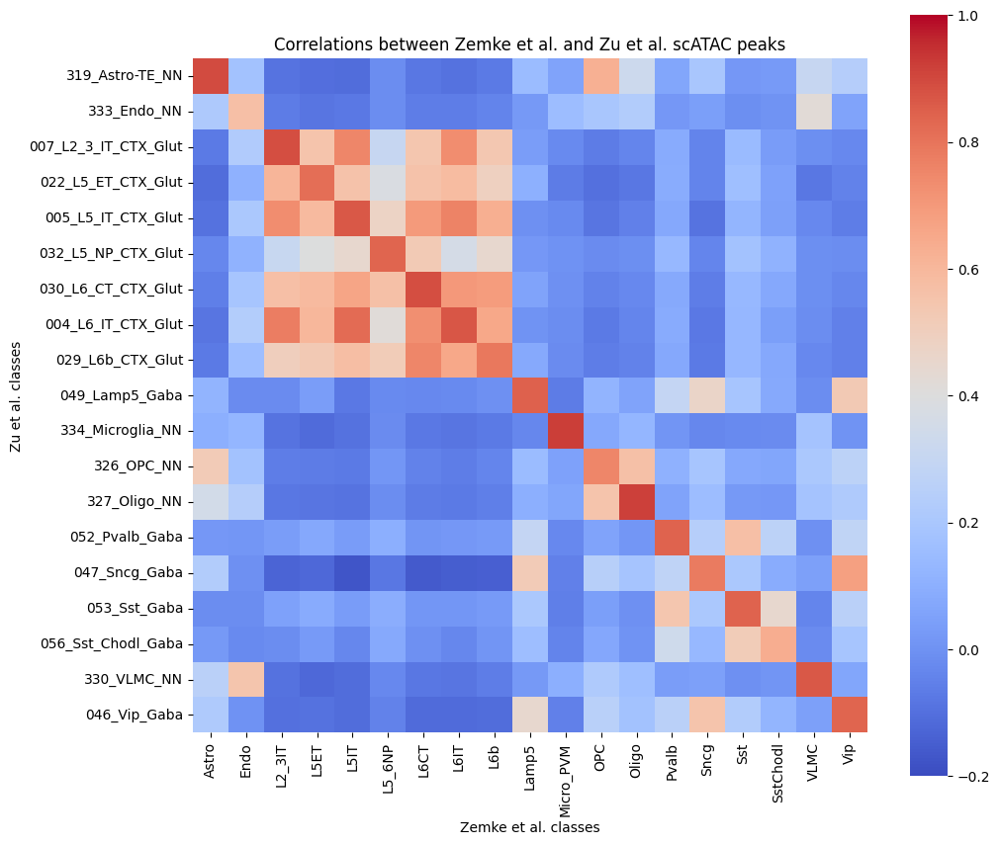

In [37]:
# Plot Zu vs BICCN 'self'-correlation heatmap
log1p = True
fig, ax = plt.subplots(figsize = (11, 10))

# Get BICCN ATAC data
x = adata_ct.X

# Get Zu ATAC data
y = adata_zu.X

if log1p:
    x = np.log1p(x)
    y = np.log1p(y)

# Plot
corr = np.zeros((x.shape[0], y.shape[0]))
for i in range(x.shape[0]):
    for j in range(y.shape[0]):
        corr[i, j] = pearsonr(x[i, :], y = y[j, :])[0]
sns.heatmap(corr.T, ax = ax, xticklabels = adata_ct.obs_names, yticklabels = adata_zu.obs_names, square = True, vmin = -0.2, vmax = 1, cmap = 'coolwarm')

ax.set_xlabel("Zemke et al. classes")
ax.set_ylabel("Zu et al. classes")
ax.set_title("Correlations between Zemke et al. and Zu et al. scATAC peaks")

fig.savefig(f"figures/self_zuatac_vs_biccnatac_heatmap{'_log1p' if log1p else ''}.pdf", dpi = 1000)

#### Fig. 5c

In [38]:
# Zu vs prediction heatmap data
log1p = True
undo_transform = False
# values from targets_mouse.txt for yangli tracks
clip_soft = 96
track_scale = 0.01
sum_stat = 'sum'

# Get ATAC data
x = adata_zu.X
# Get finetuned Borzoi preds
y_data = [adata_ct.layers["Fine-tuned DilatedCNN predictions"], adata_ct.layers["Double fine-tuned Borzoi predictions"]]
subset_list = [adata_ct.var['split'] == 'test', adata_ct.var['split'] == 'test']
# Get base Borzoi preds
if undo_transform:
    # This data uses old transform, so sum/mean -> clip -> scale, reversed when undoing
    y_base = borzoi_ad.layers['full_preds'][borzoi_matching_track_idxes, ...]
    y_base = y_base / track_scale # undo scale
    y_base = np.where(y_base > clip_soft, (y_base - clip_soft) ** 2 + clip_soft, y_base) # undo clip_soft
    if 'mean' in sum_stat:
        y_base = y_base * 32 # undo division by denominator when taking mean since we want un-tarnished sum
    y_base = y_base.sum(axis=-1)
else:
    y_base = borzoi_ad.X[borzoi_matching_track_idxes, :]
y_data.append(y_base)
subset_list.append(adata_ct.var['split_borzoi'] == 'test')

y_labels = [adata_ct.obs_names, adata_ct.obs_names, borzoi_ad.obs_names[borzoi_matching_track_idxes]]
if log1p:
    x = np.log1p(x)
    y_data = [np.log1p(y) for y in y_data]

y_corr = []
y_corr_subset = []

for plot_i, y in enumerate(y_data):    
    # Plot
    corr = np.zeros((x.shape[0], y.shape[0]))
    corr_subset = np.zeros((x.shape[0], y.shape[0]))
    for i in range(x.shape[0]):
        for j in range(y.shape[0]):
            corr[i, j] = pearsonr(x[i, :], y = y[j, :])[0]
            corr_subset[i, j] = pearsonr(x[i, subset_list[plot_i]], y[j, subset_list[plot_i]])[0]
    y_corr.append(corr)
    y_corr_subset.append(corr_subset)


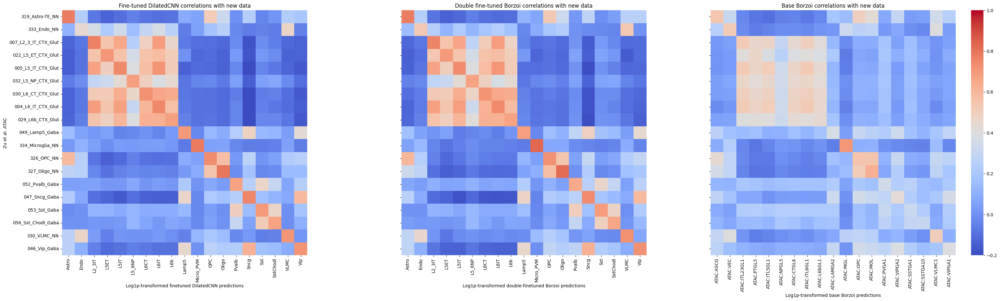

In [39]:
# Plot Zu correlation heatmaps on ct-specific test set
fig, axs = plt.subplots(1, 3, figsize = (40, 10), sharey = True)
for plot_i, corr in enumerate(y_corr_subset):    
    sns.heatmap(
        corr.T, 
        ax = axs[plot_i], 
        xticklabels = y_labels[plot_i], 
        yticklabels = adata_zu.obs_names, 
        vmin = -0.2, 
        vmax = 1, 
        cmap = 'coolwarm', 
        cbar = plot_i == len(y_corr)-1, 
        square = True
    )

axs[0].set_ylabel("Zu et al. ATAC")

axs[0].set_xlabel(f"{'Log1p-transformed f' if log1p else 'F'}inetuned DilatedCNN predictions")
axs[0].set_title("Fine-tuned DilatedCNN correlations with new data")
axs[1].set_xlabel(f"{'Log1p-transformed d' if log1p else 'D'}ouble-finetuned Borzoi predictions")
axs[1].set_title("Double fine-tuned Borzoi correlations with new data")
axs[2].set_xlabel(f"{'Log1p-transformed b' if log1p else 'B'}ase Borzoi predictions")
axs[2].set_title("Base Borzoi correlations with new data")

plt.subplots_adjust(wspace=0.1)
fig.savefig(f"figures/all_vs_zuatac_test_heatmap{'_undotrans' if undo_transform else ''}{'_log1p' if log1p else ''}_horizontal.pdf", dpi = 1000, bbox_inches='tight')


#### Extra figures

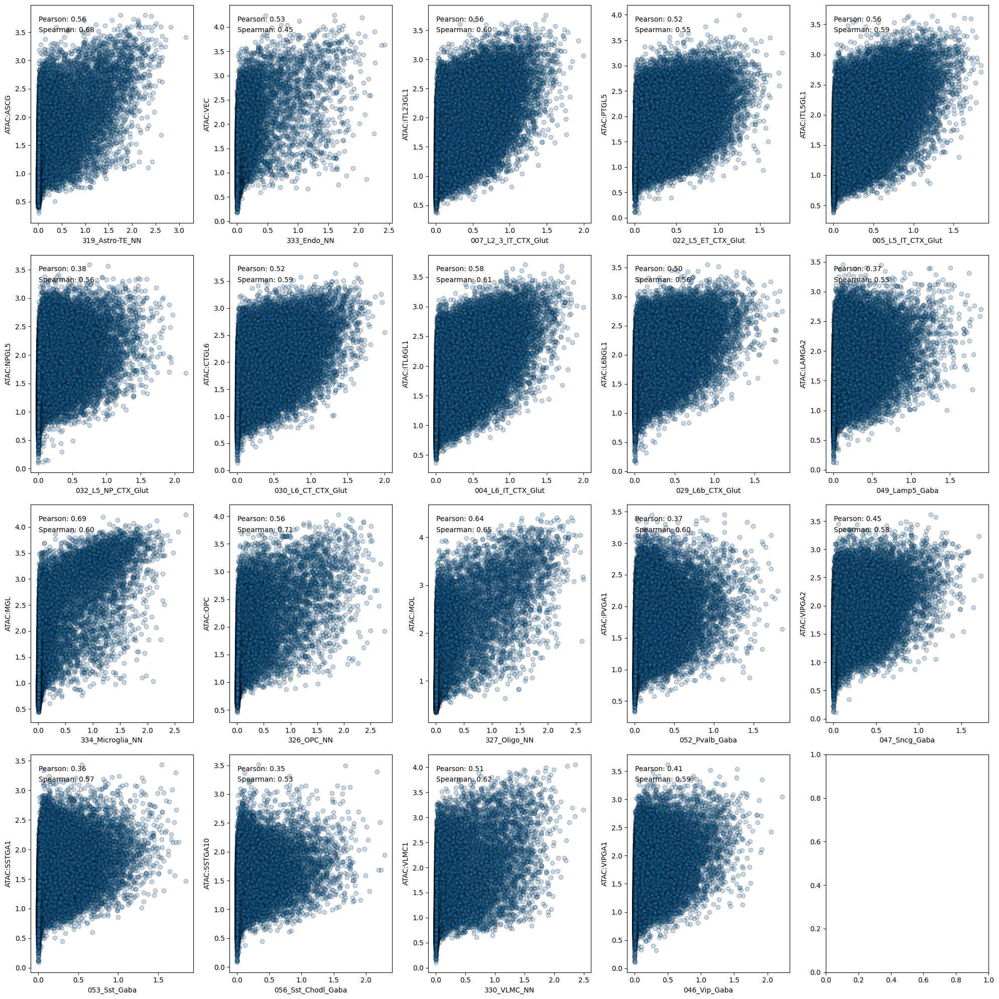

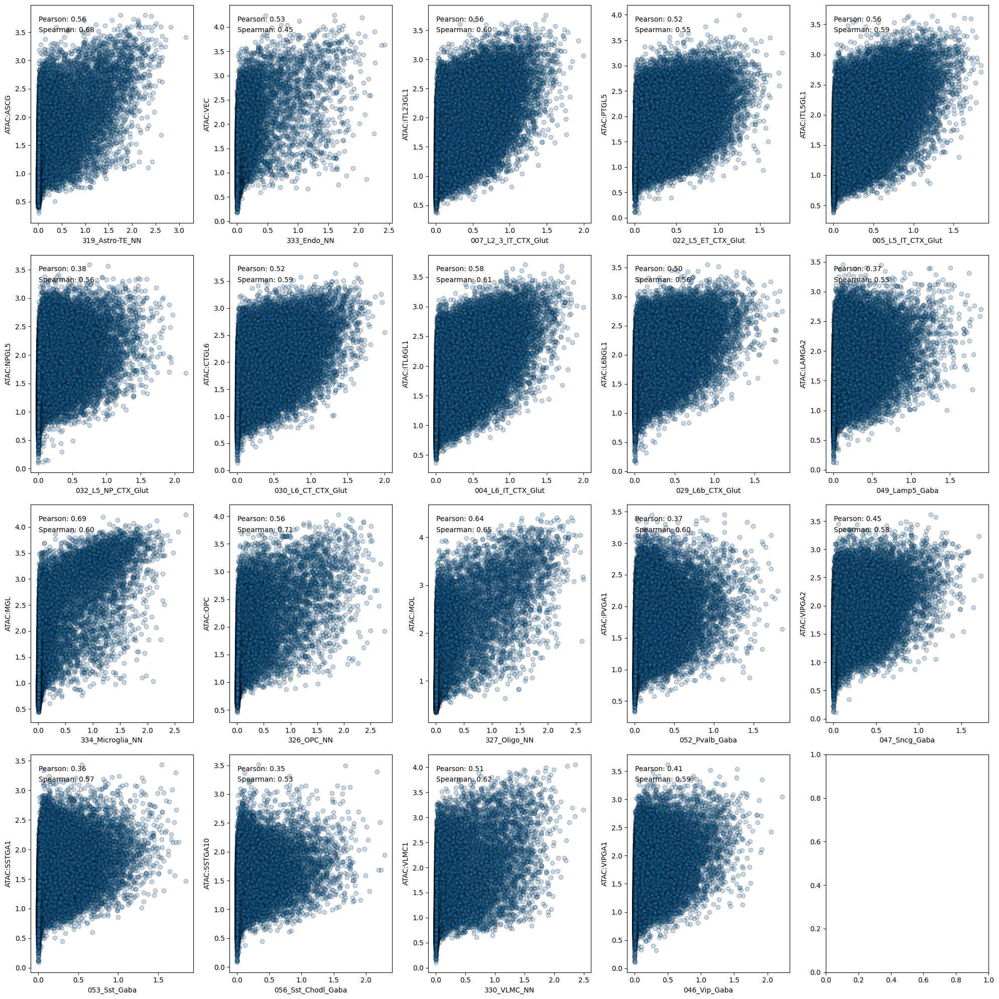

In [40]:
fig, axs = plt.subplots(4, 5, figsize = (20, 20))
log1p = True

x = adata_zu.X
y = borzoi_ad.X[borzoi_matching_track_idxes]
if log1p:
    x = np.log1p(x)
    y = np.log1p(y)
for ct_i in range(x.shape[0]):
    # Plot
    axs[ct_i//5][ct_i%5].scatter(x = x[ct_i, :], y = y[ct_i, :], edgecolor="k", alpha=0.25)
    axs[ct_i//5][ct_i%5].set_xlabel(adata_zu.obs_names[ct_i])
    axs[ct_i//5][ct_i%5].set_ylabel(borzoi_ad.obs_names[borzoi_matching_track_idxes][ct_i])
    # Add correlations
    axs[ct_i//5][ct_i%5].annotate(
        f"Pearson: {pearsonr(x[ct_i, :], y[ct_i, :])[0]:.2f}",
        xy=(0.05, 0.95),
        xycoords="axes fraction",
        verticalalignment="top",
    )
    axs[ct_i//5][ct_i%5].annotate(
        f"Spearman: {spearmanr(x[ct_i, :], y[ct_i, :])[0]:.2f}",
        xy=(0.05, 0.90),
        xycoords="axes fraction",
        verticalalignment="top",
    )
fig.tight_layout()
fig
# fig.savefig(f"figures/test_correlations{'_untransform' if undo_transform else ''}{'_log1p' if log1p else ''}.png")

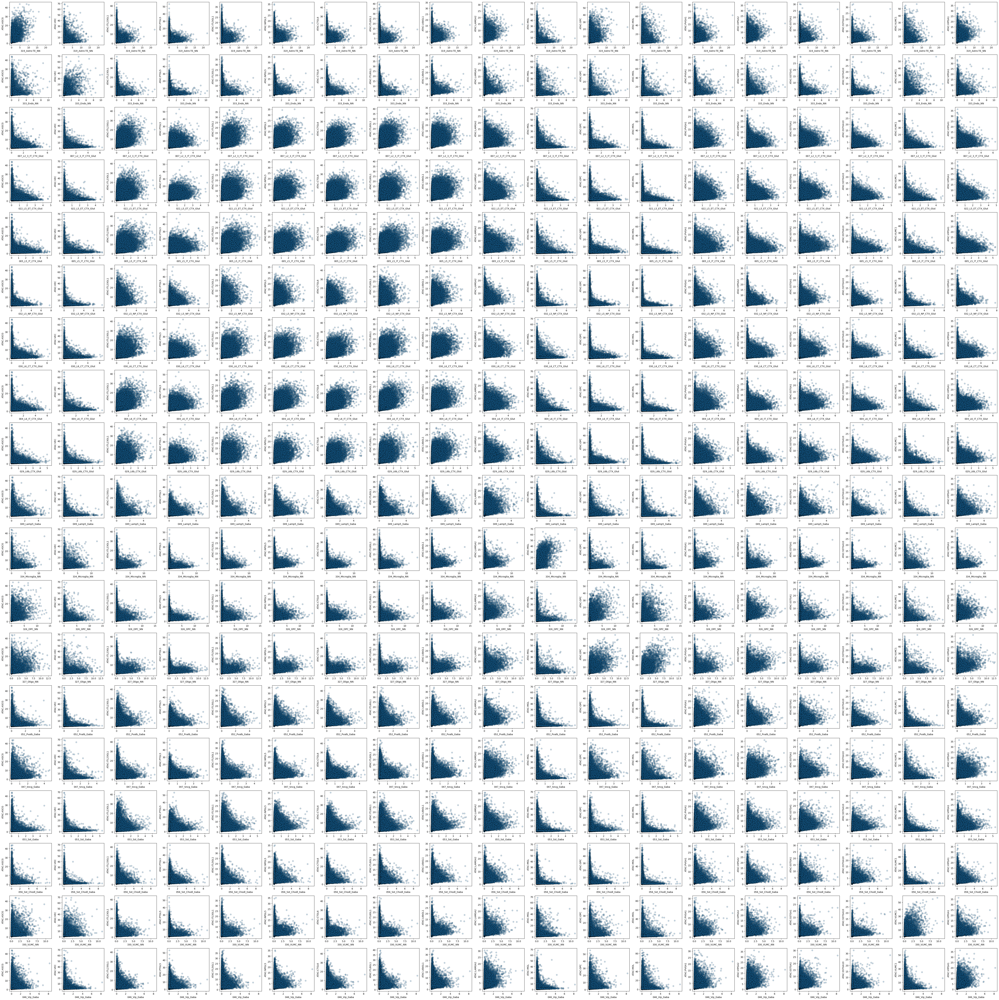

In [41]:
# Compare Borzoi microglia to all Zu et al. classes
# Pattern shows even better without non-log1p - mostly 0 at either axis for non-aligned classes, except for matching
# Would be better with 
fig, axs = plt.subplots(19, 19, figsize = (60, 60))
log1p = False

x = adata_zu.X
y = borzoi_ad.X[borzoi_matching_track_idxes, :]
if log1p:
    x = np.log1p(x)
    y = np.log1p(y)
for ct_i in range(x.shape[0]):
    for ct_j in range(y.shape[0]):
    # Plot
        axs[ct_i][ct_j].scatter(x = x[ct_i, :], y = y[ct_j, :], edgecolor="k", alpha=0.25)
        axs[ct_i][ct_j].set_xlabel(adata_zu.obs_names[ct_i])
        axs[ct_i][ct_j].set_ylabel(borzoi_ad.obs_names[borzoi_matching_track_idxes][ct_j])
fig.tight_layout()
plt.show()

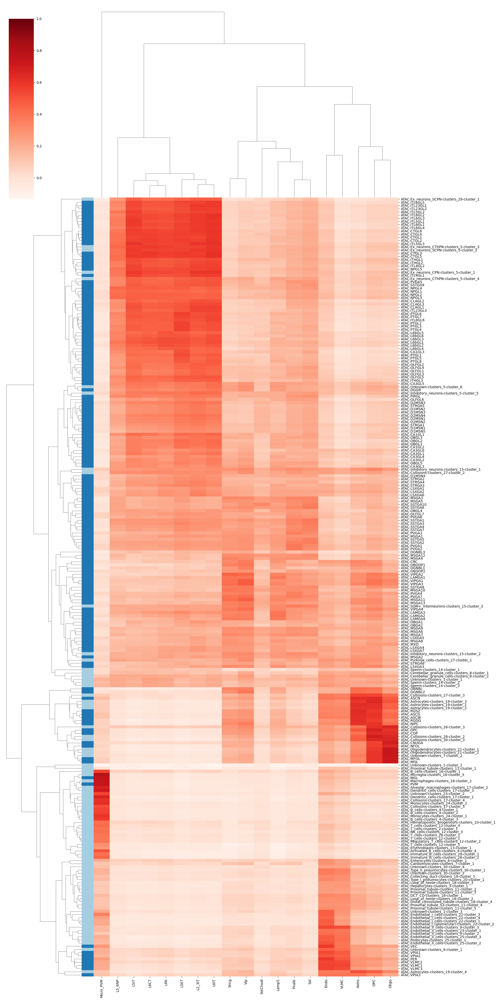

In [42]:
# Compare all base Borzoi predicted mouse brain classes against BICCN adata

data_origin = targets['file'][targets['file'].str.contains('yangli') | targets['file'].str.contains('uw-atlas')].str.extract(r"/home/drk/tillage/datasets/mouse/atac/(.+?)/.+", expand=False)
row_colors =  data_origin.map(dict(zip(data_origin.unique(), sns.color_palette("Paired", n_colors = data_origin.nunique())))).values

# Get ATAC counts
x = adata_ct.X
# Get base Borzoi preds
y = borzoi_ad.X[borzoi_all_track_idxes, :]

# Plot
corr = np.zeros((x.shape[0], y.shape[0]))
for i in range(x.shape[0]):
    for j in range(y.shape[0]):
        corr[i, j] = pearsonr(x[i, :], y = y[j, :])[0]
c = sns.clustermap(
    corr.T,
    xticklabels = adata_ct.obs_names,
    yticklabels = borzoi_ad.obs_names[borzoi_all_track_idxes],
    vmax = 1,
    cmap = 'Reds',
    figsize = (20, 40),
    row_colors = row_colors
)

c.savefig("figures/base_vs_biccnatac_all_clustermap.pdf", dpi = 1000)